In [1]:
# Change Python path
import os, sys
os.chdir("/LOCALDATA/ARTHURs_FILES/Codigos/")
print(os.getcwd())
sys.path.append('python_modules')

# Enables modules autoreload (important during development)
%load_ext autoreload
%autoreload 2

/LOCALDATA/ARTHURs_FILES/Codigos


In [5]:
from data_managers.load_dataset import load_nc_to_dataset

ds_mhws = load_nc_to_dataset("mhws_cmems_sst_balears_transposed.nc")
ds_mhws

<xarray.Dataset> Size: 30MB
Dimensions:               (lon: 120, lat: 65, year: 43)
Coordinates:
  * lon                   (lon) float32 480B -0.9592 -0.9092 ... 4.946 4.996
  * lat                   (lat) float32 260B 37.75 37.8 37.85 ... 40.91 40.96
  * year                  (year) int64 344B 1982 1983 1984 ... 2022 2023 2024
Data variables:
    count                 (lat, lon, year) float64 3MB ...
    duration              (lat, lon, year) float64 3MB ...
    intensity_max         (lat, lon, year) float64 3MB ...
    intensity_max_max     (lat, lon, year) float64 3MB ...
    intensity_mean        (lat, lon, year) float64 3MB ...
    intensity_var         (lat, lon, year) float64 3MB ...
    intensity_cumulative  (lat, lon, year) float64 3MB ...
    rate_onset            (lat, lon, year) float64 3MB ...
    rate_decline          (lat, lon, year) float64 3MB ...
    total_days            (lat, lon, year) float64 3MB ...
    total_icum            (lat, lon, year) float64 3MB ...
Attributes:
    climatologyPeriod:  1987-2021
    description:        MHWs yearly statistics computed using the marineHeatW...

In [ ]:
ds_mhws.info()

## At Dragonera

In [3]:
ds_mhws_all_dragonera = ds_mhws.sel(lon=2.10, lat=39.56, method='nearest')
ds_mhws_all_dragonera.coords

Coordinates:
    lon      float32 4B 2.094
    lat      float32 4B 39.55
  * year     (year) int64 344B 1982 1983 1984 1985 1986 ... 2021 2022 2023 2024

In [2]:
from data_managers.load_dataset import load_cmems_sst

ds_cmems_sst_dragonera = load_cmems_sst(
    # years=range(2009, 2023),
    lon_selector=2.10,
    lat_selector=39.56,
)
ds_cmems_sst_dragonera = ds_cmems_sst_dragonera.chunk({"time": -1})
ds_cmems_sst_dragonera.coords

Loaded CMEMS-SST dataset.


Coordinates:
    lat      float32 4B 39.55
    lon      float32 4B 2.094
  * time     (time) datetime64[ns] 123kB 1982-01-01 1982-01-02 ... 2023-12-31

In [23]:
from mhws_computers.marineHeatWaves import detect, blockAverage
import numpy as np

t = ds_cmems_sst_dragonera.time.values.astype('datetime64[D]').astype(int) + 719163
sst = ds_cmems_sst_dragonera.T.values

mhws, clim = detect(t, sst, climatologyPeriod=[1987,2021])
mhwBlock_dragonera = blockAverage(t, mhws, temp=sst, clim=clim, )

for year in mhwBlock_dragonera["years_centre"]:
    for stat in mhwBlock_dragonera.keys():
        mhwBlock_dragonera[stat] = np.nan_to_num(mhwBlock_dragonera[stat])

print("Years:", mhwBlock_dragonera["years_centre"])
print("Variables:", mhwBlock_dragonera.keys())

Years: [1982. 1983. 1984. 1985. 1986. 1987. 1988. 1989. 1990. 1991. 1992. 1993.
 1994. 1995. 1996. 1997. 1998. 1999. 2000. 2001. 2002. 2003. 2004. 2005.
 2006. 2007. 2008. 2009. 2010. 2011. 2012. 2013. 2014. 2015. 2016. 2017.
 2018. 2019. 2020. 2021. 2022. 2023.]
Variables: dict_keys(['count', 'duration', 'intensity_max', 'intensity_max_max', 'intensity_mean', 'intensity_cumulative', 'intensity_var', 'intensity_max_relThresh', 'intensity_mean_relThresh', 'intensity_cumulative_relThresh', 'intensity_var_relThresh', 'intensity_max_abs', 'intensity_mean_abs', 'intensity_cumulative_abs', 'intensity_var_abs', 'rate_onset', 'rate_decline', 'total_days', 'total_icum', 'temp_mean', 'temp_max', 'temp_min', 'moderate_days', 'strong_days', 'severe_days', 'extreme_days', 'years_start', 'years_end', 'years_centre'])


In [7]:
from data_managers.load_dataset import load_cmems_sst

ds_cmems_sst_four_dragonera = load_cmems_sst(
    # years=range(2009, 2023),
    lon_selector=slice(2.09, 2.15),
    lat_selector=slice(39.55, 39.62),
)
ds_cmems_sst_four_dragonera = ds_cmems_sst_four_dragonera.chunk({"time": -1})
ds_cmems_sst_four_dragonera.coords

Loaded CMEMS-SST dataset.


Coordinates:
  * lat      (lat) float32 8B 39.55 39.6
  * lon      (lon) float32 8B 2.094 2.144
  * time     (time) datetime64[ns] 123kB 1982-01-01 1982-01-02 ... 2023-12-31

In [9]:
from mhws_computers.mhw_computer import compute_mhw_maps_apply_ufunc

ds_mhws_four_dragonera = compute_mhw_maps_apply_ufunc(
    ds_cmems_sst_four_dragonera
).compute()
ds_mhws_four_dragonera = ds_mhws_four_dragonera.isel(lon=0,lat=0)
ds_mhws_four_dragonera.coords

Coordinates:
    lon      float32 4B 2.094
    lat      float32 4B 39.55
  * year     (year) int64 336B 1982 1983 1984 1985 1986 ... 2020 2021 2022 2023

### Basic variables plots

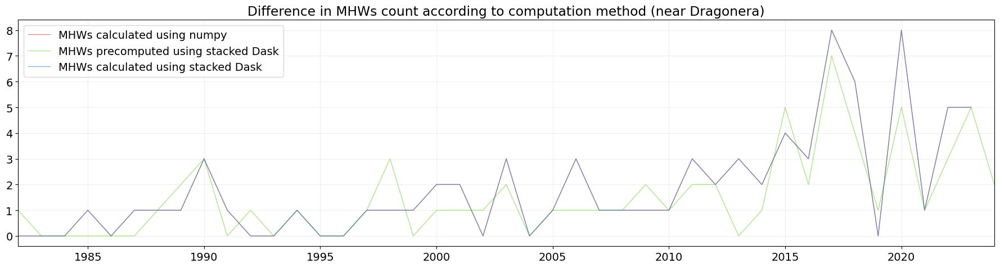

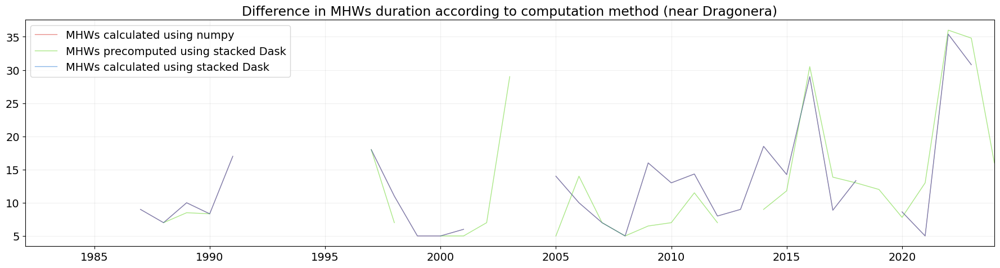

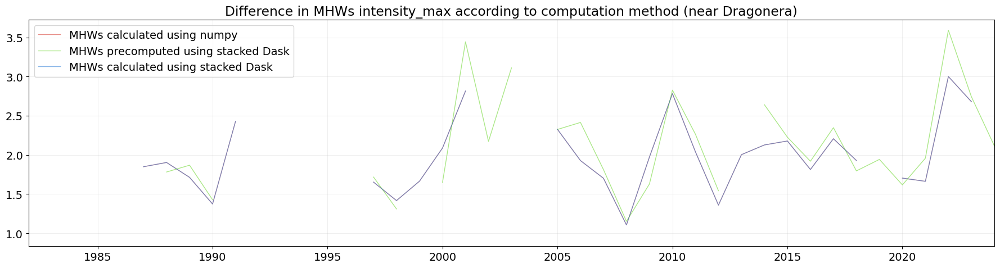

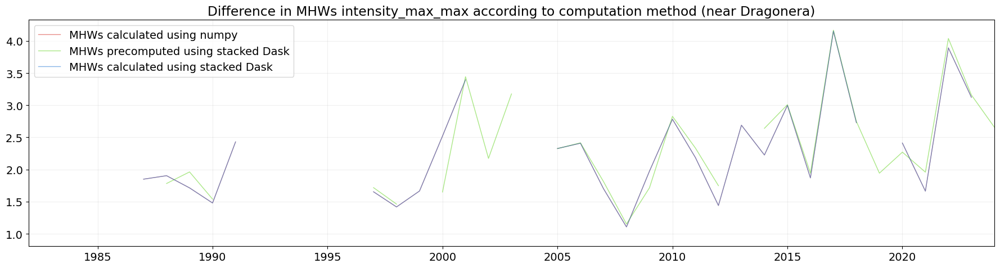

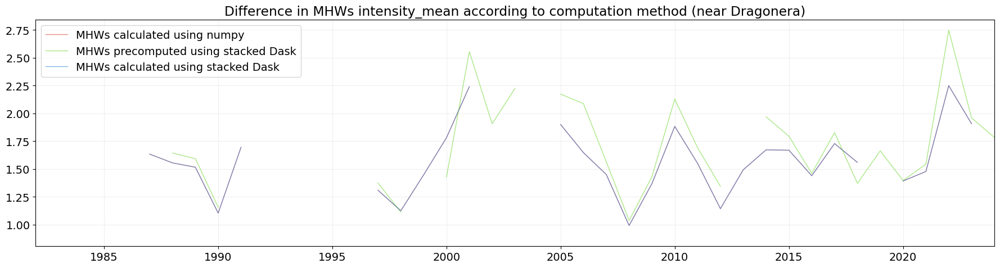

...

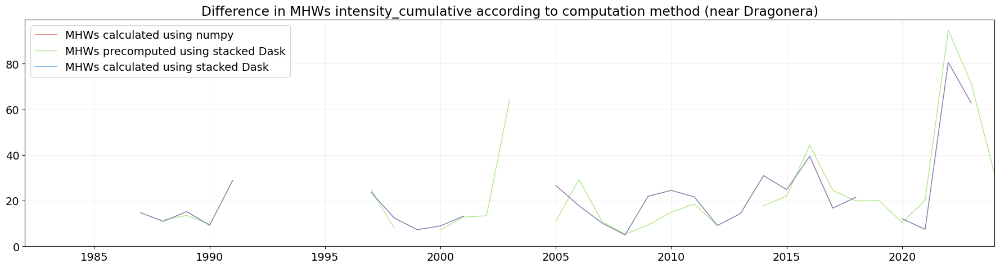

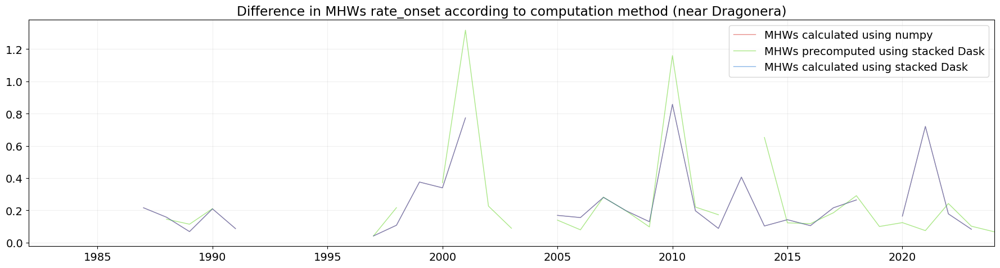

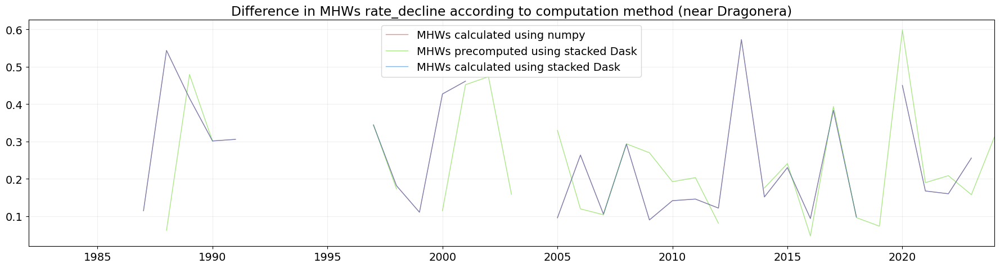

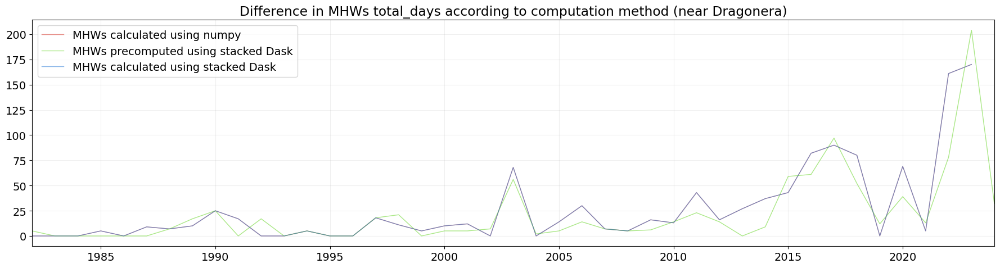

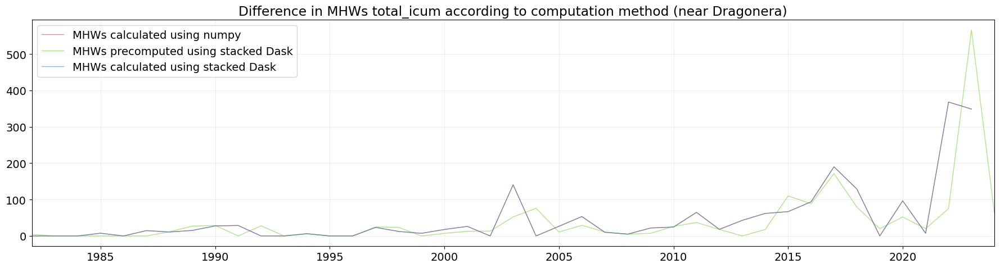

In [ ]:
from data_plotters.timeseries_TEMP import plot_timeserie

for stats in ds_mhws_all_dragonera.data_vars:
    plot_timeserie(
        {
            "np": mhwBlock_dragonera[stats],
            "dask_all": ds_mhws_all_dragonera[stats],
            "dask_quartet": ds_mhws_four_dragonera[stats],
        },
        {
            "np": mhwBlock_dragonera["years_start"],
            "dask_all": ds_mhws_all_dragonera.year,
            "dask_quartet": ds_mhws_four_dragonera.year,
        },
        labels={
            "np": "MHWs calculated using numpy",
            "dask_quartet": "MHWs calculated using stacked Dask",
            "dask_all": "MHWs precomputed using stacked Dask",
        },
        colors={
            "np": "#D42D218A",
            "dask_all": "#63D4218A",
            # "dask_quartet": "#D4B9218A",
            "dask_quartet": "#2175D48A",
        },
        xlim=(1982,2024),
        title=f"Difference in MHWs {stats} according to computation method (near Dragonera)",
        show_plot=True
    )

### Avanced new variables plots (Tmean...)

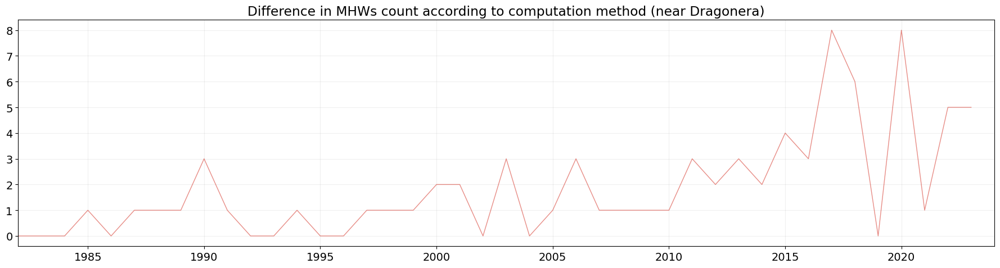

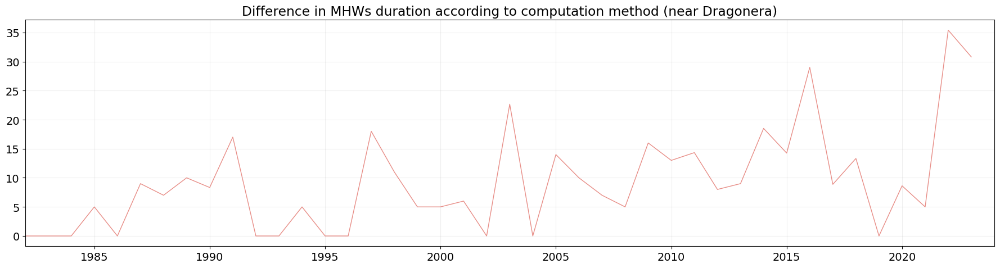

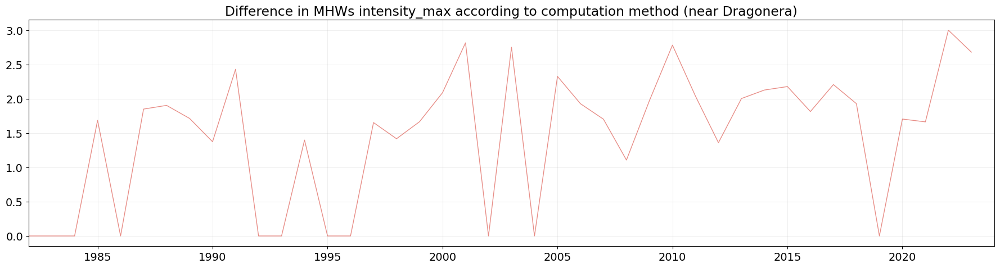

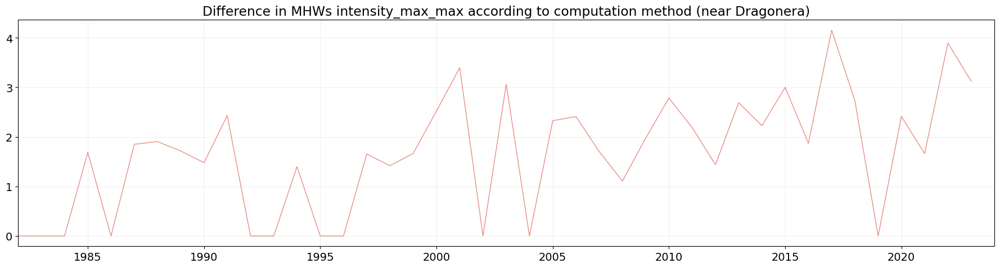

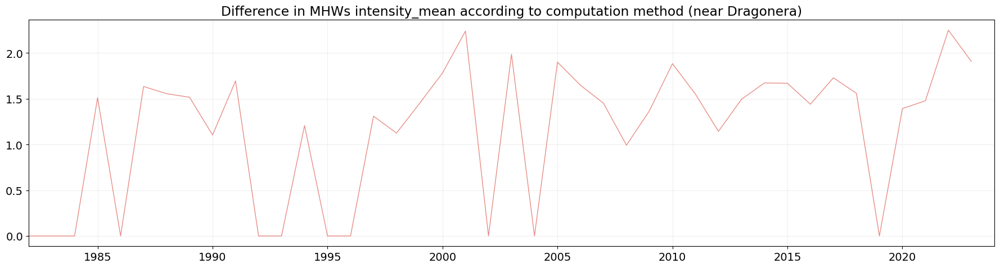

...

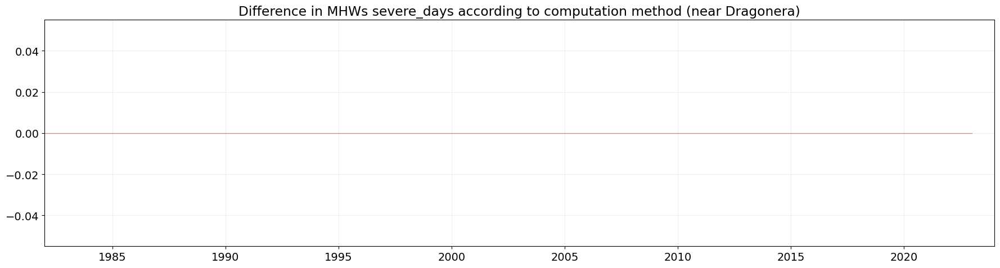

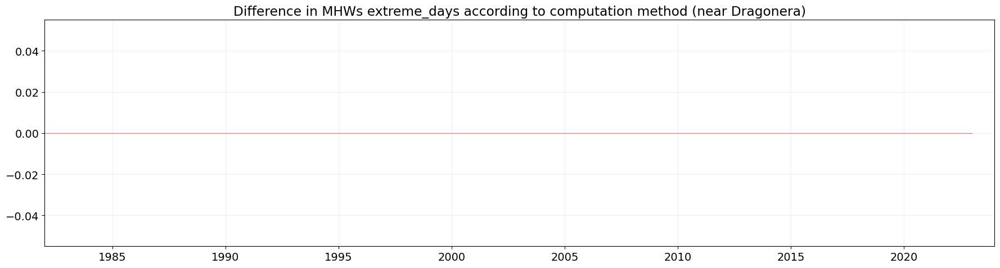

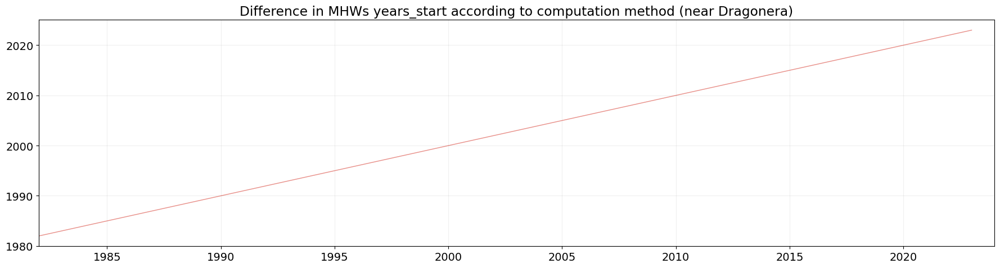

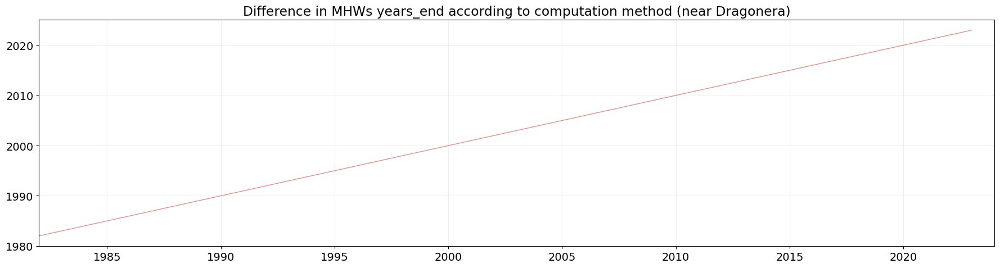

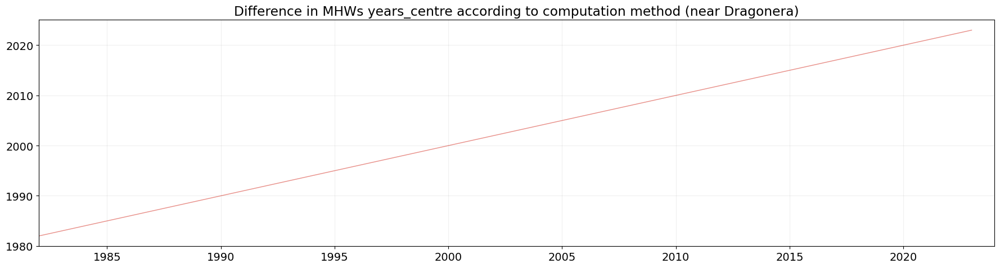

In [27]:
from data_plotters.timeseries_TEMP import plot_timeserie

for stats in mhwBlock_dragonera.keys():
    plot_timeserie(
        {
            "np": mhwBlock_dragonera[stats],
            # "dask_quartet": ds_mhws_four_dragonera[stats],
        },
        {
            "np": mhwBlock_dragonera["years_start"],
            # "dask_quartet": ds_mhws_four_dragonera.year,
        },
        labels={
            "np": "MHWs calculated using numpy",
            "dask_quartet": "MHWs calculated using stacked Dask (new)",
        },
        colors={
            "np": "#D42D218A",
            # "dask_quartet": "#D4B9218A",
            "dask_quartet": "#2175D48A",
        },
        xlim=(1982,2024),
        title=f"Difference in MHWs {stats} according to computation method (near Dragonera)",
        show_plot=True
    )

## 20 Random points

In [88]:
import numpy as np

lon_a, lon_b = -0.9592, 4.996
lat_a, lat_b = 37.75, 40.96

# lons = np.linspace(lon_a, lon_b, 20)
# lats = np.linspace(lat_a, lat_b, 20)

sub_mhws = ds_mhws.isel(lon=np.linspace(0, ds_mhws.lon.size-1, 10, dtype=int))
lons = sub_mhws.lon.values
lats = sub_mhws.lat.values

In [90]:
from data_managers.load_dataset import load_cmems_sst

ds_cmems_sst_20 = load_cmems_sst(
    # years=range(2009, 2023),
    lon_selector=lons,
    lat_selector=lats,
)
# ds_cmems_sst_20 = ds_cmems_sst_20.sortby(["lat", "lon"])
ds_cmems_sst_20 = ds_cmems_sst_20.chunk({"time": -1})
ds_cmems_sst_20.coords

Loaded CMEMS-SST dataset.


Coordinates:
  * lat      (lat) float32 260B 37.75 37.8 37.85 37.9 ... 40.86 40.91 40.96
  * lon      (lon) float32 40B -0.9592 -0.3086 0.342 ... 3.645 4.296 4.996
  * time     (time) datetime64[ns] 123kB 1982-01-01 1982-01-02 ... 2023-12-31

In [99]:
from mhws_computers.marineHeatWaves import detect, blockAverage
import xarray as xr

stats = ['count', 'duration', 'intensity_max', 'intensity_max_max', 'intensity_mean', 'intensity_var', 'intensity_cumulative', 'rate_onset', 'rate_decline', 'total_days', 'total_icum', 'temp_mean', 'temp_max', 'temp_min', 'moderate_days', 'strong_days', 'severe_days', 'extreme_days']
mhws_numpy_20: dict = {}

for i, lon in enumerate(lons):
    # if i > 1:
    #     break

    ds = ds_cmems_sst_20.isel(lon=i, lat=i)
    t = ds.time.values.astype('datetime64[D]').astype(int) + 719163
    sst = ds.T.values

    mhws, clim = detect(t, sst, climatologyPeriod=[1987,2021])
    mhwBlock = blockAverage(t, mhws, temp=sst, clim=clim)

    # print("Years:", mhwBlock_dragonera["years_centre"])
    # print("Variables:", mhwBlock_dragonera.keys())

    for stat in mhwBlock.keys():
        if mhws_numpy_20.get(stat) is None:
            mhws_numpy_20[stat] = np.expand_dims(mhwBlock[stat], axis=0)
        else:
            mhws_numpy_20[stat] = np.append(mhws_numpy_20[stat], np.expand_dims(mhwBlock[stat], axis=0), axis=0)
    
    print(f"Done {i+1}/{len(lons)}")

print(list(mhws_numpy_20.keys()))
print(mhws_numpy_20["count"].shape)

/home/arthur/.local/lib/python3.10/site-packages/numpy/lib/nanfunctions.py:1384: RuntimeWarning: All-NaN slice encountered
  return _nanquantile_unchecked(
/LOCALDATA/ARTHURs_FILES/Codigos/python_modules/mhws_computers/marineHeatWaves.py:293: RuntimeWarning: Mean of empty slice
  seas_climYear[d-1] = np.nanmean(tempClim[tt.astype(int)])
/LOCALDATA/ARTHURs_FILES/Codigos/python_modules/mhws_computers/marineHeatWaves.py:659: RuntimeWarning: Mean of empty slice
  mhwBlock['temp_mean'][i] = np.nanmean(temp[tt])
/LOCALDATA/ARTHURs_FILES/Codigos/python_modules/mhws_computers/marineHeatWaves.py:660: RuntimeWarning: All-NaN slice encountered
  mhwBlock['temp_max'][i] = np.nanmax(temp[tt])
/LOCALDATA/ARTHURs_FILES/Codigos/python_modules/mhws_computers/marineHeatWaves.py:661: RuntimeWarning: All-NaN slice encountered
  mhwBlock['temp_min'][i] = np.nanmin(temp[tt])


['count', 'duration', 'intensity_max', 'intensity_max_max', 'intensity_mean', 'intensity_cumulative', 'intensity_var', 'intensity_max_relThresh', 'intensity_mean_relThresh', 'intensity_cumulative_relThresh', 'intensity_var_relThresh', 'intensity_max_abs', 'intensity_mean_abs', 'intensity_cumulative_abs', 'intensity_var_abs', 'rate_onset', 'rate_decline', 'total_days', 'total_icum', 'temp_mean', 'temp_max', 'temp_min', 'moderate_days', 'strong_days', 'severe_days', 'extreme_days', 'years_start', 'years_end', 'years_centre']
(10, 42)


In [92]:
from mhws_computers.mhw_computer import compute_mhw_maps_apply_ufunc

ds_mhws_20 = compute_mhw_maps_apply_ufunc(
    ds_cmems_sst_20
).compute()
ds_mhws_20.coords

Coordinates:
  * lon      (lon) float32 40B -0.9592 -0.3086 0.342 ... 3.645 4.296 4.996
  * lat      (lat) float32 260B 37.75 37.8 37.85 37.9 ... 40.86 40.91 40.96
  * year     (year) int64 336B 1982 1983 1984 1985 1986 ... 2020 2021 2022 2023

In [101]:
ds_mhws_20.data_vars

Data variables:
    count                 (lat, lon, year) float64 218kB 0.0 0.0 0.0 ... 7.0 7.0
    duration              (lat, lon, year) float64 218kB nan nan ... 22.0 14.29
    intensity_max         (lat, lon, year) float64 218kB nan nan ... 3.654 2.833
    intensity_max_max     (lat, lon, year) float64 218kB nan nan ... 4.484 4.075
    intensity_mean        (lat, lon, year) float64 218kB nan nan ... 2.759 2.196
    intensity_var         (lat, lon, year) float64 218kB nan nan ... 0.3785
    intensity_cumulative  (lat, lon, year) float64 218kB nan nan ... 57.45 33.43
    rate_onset            (lat, lon, year) float64 218kB nan nan ... 0.3808
    rate_decline          (lat, lon, year) float64 218kB nan nan ... 0.3983
    total_days            (lat, lon, year) float64 218kB 0.0 0.0 ... 134.0 120.0
    total_icum            (lat, lon, year) float64 218kB 0.0 0.0 ... 326.5 309.6
    temp_mean             (lat, lon, year) float64 218kB nan nan ... 19.91 19.77
    temp_max              (l

### Basic variables plots

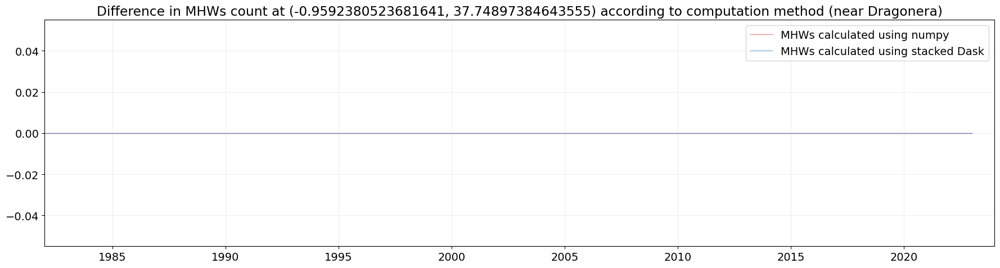

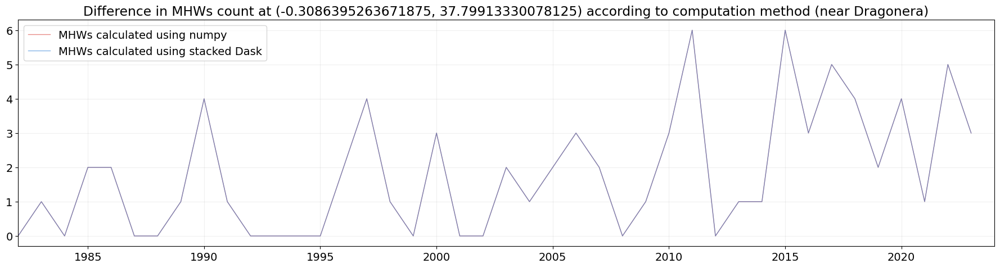

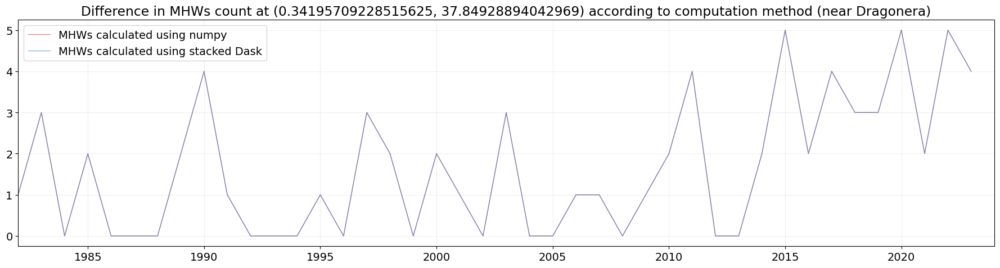

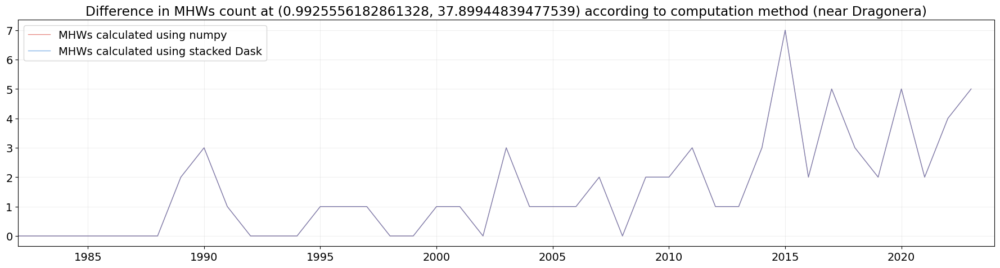

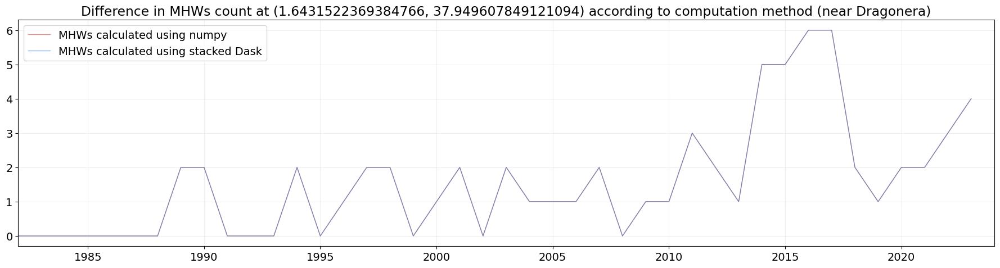

...

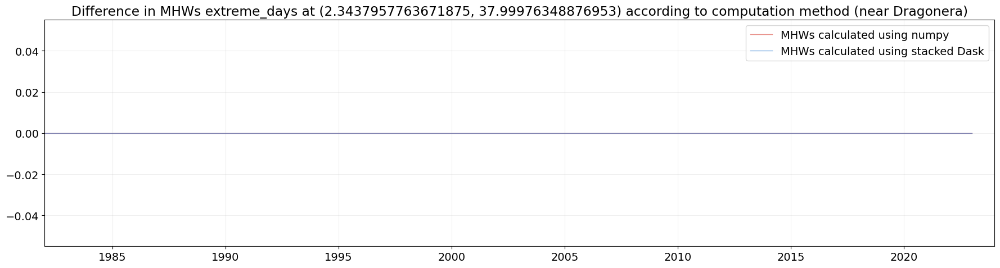

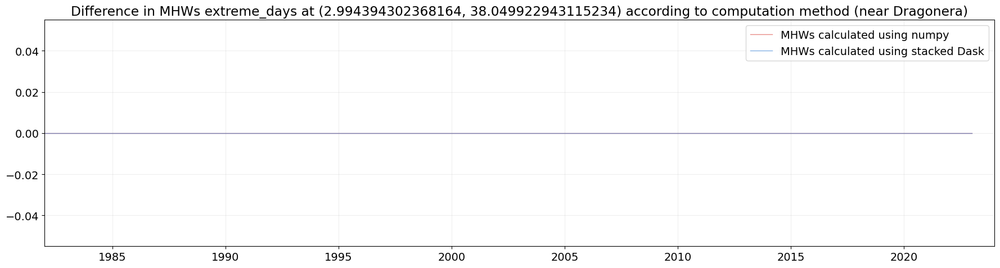

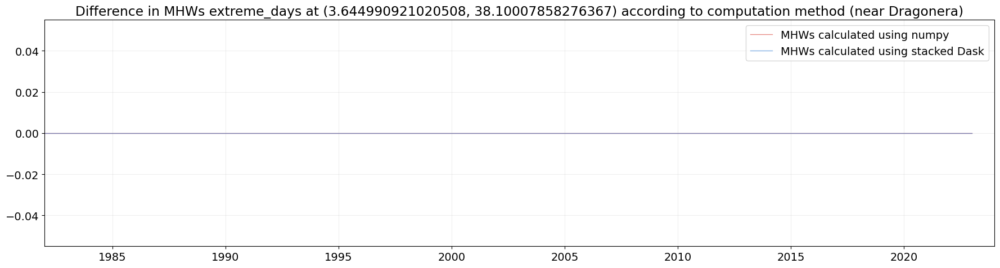

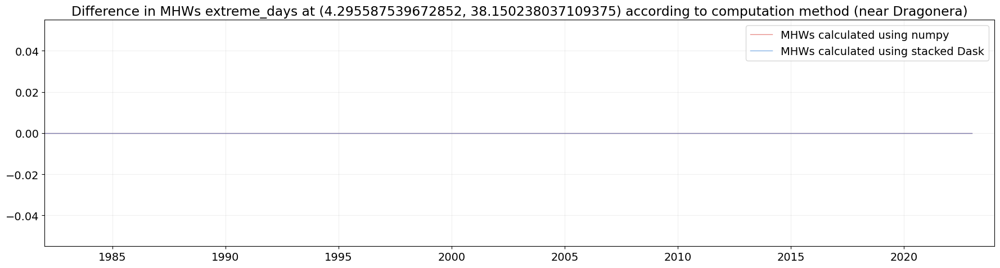

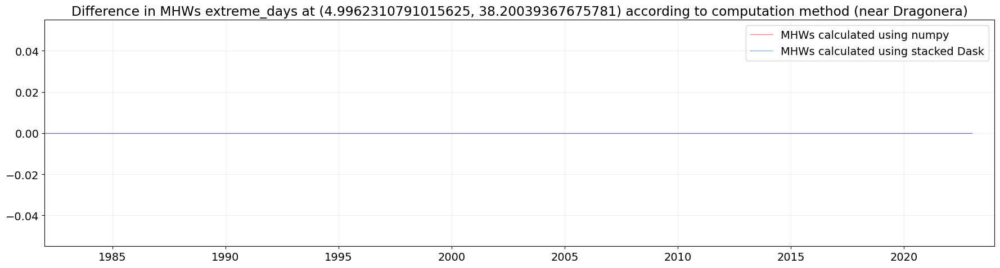

In [104]:
from data_plotters.timeseries_TEMP import plot_timeserie

for stats in ds_mhws_20.data_vars:
    for i in range(len(mhws_numpy_20[stats])):
        plot_timeserie(
            {
                "np": mhws_numpy_20[stats][i],
                # "dask_all": ds_mhws.sel(lon=lons[i],lat=lats[i], method='nearest')[stats],
                "dask_four": ds_mhws_20.sel(lon=lons[i],lat=lats[i], method='nearest')[stats],
                # "tmean": ds_mhws_20.sel(lon=lons[i],lat=lats[i], method='nearest')["temp_mean"],
            },
            {
                "np": mhws_numpy_20["years_start"][i],
                # "dask_all": ds_mhws.sel(lon=lons[i],lat=lats[i], method='nearest').year,
                "dask_four": ds_mhws_20.sel(lon=lons[i],lat=lats[i], method='nearest').year,
                "tmean": ds_mhws_20.sel(lon=lons[i],lat=lats[i], method='nearest').year,
            },
            labels={
                "np": "MHWs calculated using numpy",
                "dask_all": "MHWs precomputed using stacked Dask",
                "dask_four": "MHWs calculated using stacked Dask",
                "tmean": "Temperature mean",
            },
            colors={
                "np": "#D42D218A",
                "dask_all": "#63D4218A",
                # "dask_four": "#D4B9218A",
                "dask_four": "#2175D48A",
                "tmean": "#7C7C7C8A",
            },
            xlim=(1982,2024),
            title=f"Difference in MHWs {stats} at ({lons[i]}, {lats[i]}) according to computation method (near Dragonera)",
            show_plot=True
        )